<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Transportation-Network-Preparation-and-Demand-Analysis" data-toc-modified-id="Transportation-Network-Preparation-and-Demand-Analysis-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Transportation Network Preparation and Demand Analysis</a></span><ul class="toc-item"><li><span><a href="#Network-Preparation" data-toc-modified-id="Network-Preparation-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Network Preparation</a></span></li><li><span><a href="#Demand-Generation" data-toc-modified-id="Demand-Generation-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Demand Generation</a></span></li></ul></li><li><span><a href="#Transportation-Mobility-Data-Collection-and-Analysis" data-toc-modified-id="Transportation-Mobility-Data-Collection-and-Analysis-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Transportation Mobility Data Collection and Analysis</a></span><ul class="toc-item"><li><span><a href="#Mobility-Data" data-toc-modified-id="Mobility-Data-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Mobility Data</a></span></li></ul></li><li><span><a href="#Large-Language-Model-Advances-the-Transportation-Analysis" data-toc-modified-id="Large-Language-Model-Advances-the-Transportation-Analysis-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Large Language Model Advances the Transportation Analysis</a></span></li></ul></div>

# IRF AI and Road Safety Leveraging ITS Video Assets for Vision Zero
- Roads & Transport Authority (RTA)
- Time: 09/03/2024
- Presenter: Xiangyong Roy Luo（xluo70@asu.edu）

Topic: Hand-on Tutorial on Transportation Basics and Applications
- Transportation Network Preparation and Demand Analysis
- Transportation Mobility Data Collection and Analysis
- Large Language Model Advances the Transportation Analysis

## Transportation Network Preparation and Demand Analysis
### Network Preparation

Introduction:
- Open-source Data collection: OpenStreetMap: https://www.openstreetmap.org/#map=7/34.098/-111.061
- Open-source Data Standardization: GMNS(General Modeling Network Specification): https://github.com/zephyr-data-specs/GMNS
- ASU-Transit-AI-Lab: https://github.com/asu-trans-ai-lab (focusing on open-source tools for integrating AI methods with transportation systems)
- Area of Interests: Dubai, United Arab Emirates

In [ ]:
# Install open-source packages
# osm2gmns is updating frequently, so please use the specified version to avoid compatibility issues.
!pip install pandas
!pip install osm2gmns==0.7.5
!pip install pyufunc
!pip install grid2demand
!pip install gtfs2gmns
!pip install keplergl==0.3.0


  Using cached osm2gmns-0.7.5-py3-none-any.whl.metadata (6.5 kB)
Using cached osm2gmns-0.7.5-py3-none-any.whl (77 kB)
  Attempting uninstall: osm2gmns
    Found existing installation: osm2gmns 1.0.0b1
    Uninstalling osm2gmns-1.0.0b1:
      Successfully uninstalled osm2gmns-1.0.0b1


y


In [ ]:
ls

bin@                        datalab/  lib@     media/                    proc/        sbin@  tools/
boot/                       dev/      lib32@   mnt/                      python-apt/  srv/   usr/
content/                    etc/      lib64@   NGC-DL-CONTAINER-LICENSE  root/        sys/   var/
cuda-keyring_1.0-1_all.deb  home/     libx32@  opt/                      run/         tmp/


In [ ]:
# Download network data from OpenStreetMap
import osm2gmns as og
import pyufunc as pf
import grid2demand as gd

# find the relation id from OpenStreetMap fro the place of interests
dubai_id = pf.get_osm_place('Dubai, UAE')
phoenix_id = pf.get_osm_place('Phoenix, AZ')
print("The relation id for Dubai is: \n", dubai_id)

# download the network data from OpenStreetMap
og.downloadOSMData(dubai_id["osm_id"], 'dubai_net.osm')
print("The network data of Dubai has been downloaded successfully.")

# install the latest version of osm2gmns to support the latest features
!pip uninstall osm2gmns
!pip install osm2gmns==1.0.0b1
import osm2gmns as og


The relation id for Dubai is: 
 {'bbox_north': '25.5250676', 'bbox_south': '24.6230661', 'bbox_east': '56.2036202', 'bbox_west': '54.7153981', 'place_id': 71209090, 'osm_type': 'relation', 'osm_id': 4479752, 'lat': '25.074282349999997', 'lon': '55.18853865430702', 'class': 'boundary', 'type': 'administrative', 'place_rank': 25, 'importance': 0.6934036776052183, 'addresstype': 'city', 'name': 'Dubai', 'display_name': 'Dubai, United Arab Emirates', 'geometry': <MULTIPOLYGON (((54.715 25.069, 54.743 25.044, 54.772 25.017, 54.803 24.989,...>}
valid reponses got from API server.
receving data...
map data has been written to dubai_net.osm
The network data of Dubai has been downloaded successfully.
Found existing installation: osm2gmns 0.7.5
Uninstalling osm2gmns-0.7.5:
  Would remove:
    /usr/local/lib/python3.10/dist-packages/osm2gmns-0.7.5.dist-info/*
    /usr/local/lib/python3.10/dist-packages/osm2gmns/*
    /usr/local/lib/python3.10/dist-packages/tests/*
Proceed (Y/n)? 

In [ ]:
# load the network data from OpenStreetMap and generate the network files, including nodes.csv, link.csv and poi.csv
net = og.getNetFromFile('dubai_net.osm', POI=True)
og.consolidateComplexIntersections(net, auto_identify=True)
# og.connectPOIWithNet(net)
og.outputNetToCSV(net)

arguments used for network parsing:
  filename: dubai_net.osm
  network_types: ('auto',)
  link_types: all
  POI: True
  POI_sampling_ratio: 1.0
  strict_mode: True
  offset: no
  min_nodes: 1
  combine: False
  bbox: None
  default_lanes: False
  default_speed: False
  default_capacity: False
  start_node_id: 0
  start_link_id: 0

Building Network from OSM file
  reading osm file
  parsing osm network
    generating nodes and links
    generating POIs
  number of nodes: 77709, number of links: 153335, number of pois: 248599
Consolidating Complex Intersections
    91 intersections have been consolidated
Outputting Network Files


In [ ]:
# visualize the network

import pandas as pd
import pyufunc as pf

path_node = pf.path2linux('node.csv')
path_link = 'link.csv'
path_poi = 'poi.csv'

df_node = pd.read_csv(path_node)
df_link = pd.read_csv(path_link)
df_poi = pd.read_csv(path_poi)


<ipython-input-10-f5196b5ab16f>:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_node = pd.read_csv(path_node)
<ipython-input-10-f5196b5ab16f>:12: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  df_poi = pd.read_csv(path_poi)


In [ ]:
df_node.head()

,name,node_id,osm_node_id,osm_highway,zone_id,ctrl_type,node_type,activity_type,is_boundary,x_coord,y_coord,intersection_id,poi_id,notes
0,NaN,0,90031463,NaN,NaN,NaN,NaN,NaN,NaN,55.365407,25.120153,NaN,NaN,NaN
1,NaN,1,1149158725,NaN,NaN,NaN,NaN,NaN,NaN,55.382421,25.139361,NaN,NaN,NaN
2,NaN,2,10006732394,NaN,NaN,NaN,NaN,NaN,NaN,55.387390,25.150932,NaN,NaN,NaN
3,NaN,3,2330969717,motorway_junction,NaN,NaN,NaN,NaN,NaN,55.387625,25.151455,NaN,NaN,NaN
4,Exit 50,4,95110025,motorway_junction,NaN,NaN,NaN,NaN,NaN,55.388342,25.153183,NaN,NaN,NaN


In [ ]:
df_link.head()

,name,link_id,osm_way_id,from_node_id,to_node_id,dir_flag,length,lanes,free_speed,capacity,link_type_name,link_type,geometry,allowed_uses,from_biway,is_link,VDF_fftt1,VDF_cap1
0,شارع الشيخ محمد بن زايد,0,4009554,0,1,1,2771.09,6.0,110.0,NaN,motorway,1,"LINESTRING (55.3654066 25.1201526, 55.3683512 ...",auto,0,0,NaN,NaN
1,شارع الشيخ محمد بن زايد,1,4009554,1,2,1,1375.79,6.0,110.0,NaN,motorway,1,"LINESTRING (55.3824206 25.1393608, 55.3830336 ...",auto,0,0,NaN,NaN
2,شارع الشيخ محمد بن زايد,2,4009554,2,3,1,62.55,6.0,110.0,NaN,motorway,1,"LINESTRING (55.3873900 25.1509321, 55.3876249 ...",auto,0,0,NaN,NaN
3,شارع الشيخ محمد بن زايد,3,4009554,3,4,1,204.50,6.0,110.0,NaN,motorway,1,"LINESTRING (55.3876249 25.1514550, 55.3883417 ...",auto,0,0,NaN,NaN
4,شارع الشيخ محمد بن زايد,4,4009554,4,5,1,1026.51,6.0,110.0,NaN,motorway,1,"LINESTRING (55.3883417 25.1531827, 55.3904814 ...",auto,0,0,NaN,NaN


In [ ]:
df_poi.head()

,name,poi_id,osm_way_id,osm_relation_id,building,amenity,leisure,way,geometry,centroid,area,area_ft2
0,Concourse C,0,10315513.0,NaN,airport_terminal,NaN,NaN,NaN,"POLYGON ((55.3504892 25.2542975, 55.350756 25....",POINT (55.353988 25.2526654),52928.2,569713.6
1,Jumeirah Beach Hotel,1,10316322.0,NaN,yes,NaN,NaN,NaN,"POLYGON ((55.191259 25.1423108, 55.1912423 25....",POINT (55.1907292 25.141572),4325.3,46557.0
2,NaN,2,10574160.0,NaN,NaN,parking,NaN,NaN,"POLYGON ((55.345273 25.3181582, 55.3454006 25....",POINT (55.3460186 25.3183164),6606.5,71111.3
3,NaN,3,10574198.0,NaN,NaN,parking,NaN,NaN,"POLYGON ((55.3510811 25.3223125, 55.3510804 25...",POINT (55.3515252 25.3222063),10086.4,108568.9
4,NaN,4,10574202.0,NaN,NaN,parking,NaN,NaN,"POLYGON ((55.3524518 25.3249017, 55.3520769 25...",POINT (55.3519839 25.3252661),4335.6,46668.2


In [ ]:
# enable visualization widget
from google.colab import output
output.enable_custom_widget_manager()

In [ ]:
# visualize the network
from keplergl import KeplerGl
map_dubai  = KeplerGl(height=600)
# map_dubai.add_data(data=df_node, name='node')
map_dubai.add_data(data=df_link, name='link')
# map_dubai.add_data(data=df_poi, name='poi')
map_dubai

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


Support for third party widgets will remain active for the duration of the session. To disable support:

### Demand Generation

In [ ]:

import grid2demand as gd

# multiprocessing requires the if __name__ == "__main__": in the main
if __name__ == "__main__":
    input_dir = './content'

    # Initialize a GRID2DEMAND object
    net = gd.GRID2DEMAND(input_dir=input_dir)

    # load network: node and poi
    net.load_network()

    # Generate zone dictionary from node dictionary by specifying number of x blocks and y blocks
    net.net2zone(num_x_blocks=10, num_y_blocks=10)
    # net.net2zone(cell_width=10, cell_height=10, unit="km")

    # Calculate demand by running gravity model
    net.run_gravity_model()

    # Save demand, zone, updated node, updated poi to csv
    net.save_results_to_csv()


100%|██████████| 78/78 [00:12<00:00,  6.11it/s]


  :INFO: finished function: read_node, total: 17s 



100%|██████████| 249/249 [00:49<00:00,  5.07it/s]


  :INFO: finished function: read_poi, total: 50s 

  : Generating zone dictionary...
  :INFO: finished function: net2zone, total: 0s 

  : Synchronizing zone with node...

  :INFO: finished function: sync_zone_geometry_and_node, total: 52s 

  : Synchronizing zone with poi...

  :INFO: finished function: sync_zone_geometry_and_poi, total: 110s 

  :INFO: finished function: calc_zone_od_matrix, total: 17s 

  No trip rate file provided, use default trip rate.
  : Successfully generated poi trip rate with default setting.
  : Successfully generated OD demands.
  : Successfully saved demand.csv to /content
  : Successfully saved zone.csv to /content
  : Successfully saved updated node to node.csv to /content
  : Successfully saved updated poi to poi.csv to /content


In [ ]:
# visualize the demand and zone
import pandas as pd
import pyufunc as pf
from keplergl import KeplerGl
import geopandas as gpd
import shapely

path_zone = './content/zone.csv'
path_demand = './content/demand.csv'

df_zone = pd.read_csv(path_zone)
df_demand = pd.read_csv(path_demand)

gdf_node = gpd.GeoDataFrame(df_node, geometry=gpd.points_from_xy(df_node.x_coord, df_node.y_coord))
gdf_link = gpd.GeoDataFrame(df_link, geometry=df_link['geometry'].apply(shapely.wkt.loads))
# gdf_zone = gpd.GeoDataFrame(df_zone, geometry=df_zone['geometry'].apply(shapely.wkt.loads))

<Axes: >

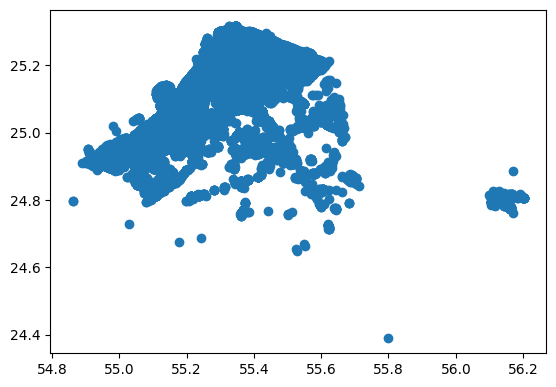

In [ ]:
gdf_node.plot()

<Axes: >

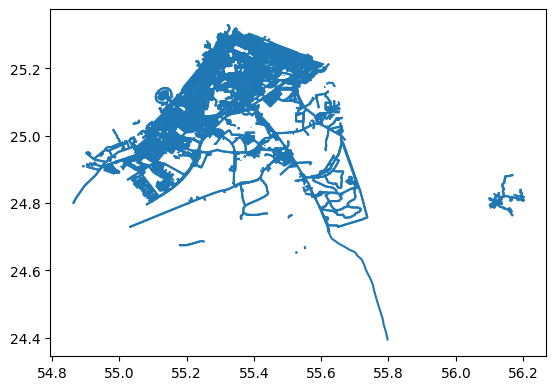

In [ ]:
gdf_link.plot()

In [ ]:
df_demand[df_demand["volume"] > 0].head()

,o_zone_id,d_zone_id,dist_km,volume
203,2,3,13.470158,7120.037061
204,2,4,26.940312,675.336258
205,2,5,40.410460,7.398755
211,2,11,16.967640,4.290152
212,2,12,10.311022,4948.050800


## Transportation Mobility Data Collection and Analysis

### Mobility Data
Background:

- Google Mobility Data:
- Google Mobility Data Specification: General Transit Feed Specification (GTFS): https://gtfs.org/getting_started/what_is_GTFS/ ![image.png](attachment:image.png)
  
- Mobility Data Source:
  - World: https://mobilitydatabase.org/
  - Dubai: https://mobilitydatabase.org/feeds/mdb-904


In [ ]:
# you will download the data from the link above and then unzip the file in your local directory
# I have downloaded the Dubai GTFS data and uploaded it to dir: _1_mobility_gtfs

from gtfs2gmns import GTFS2GMNS

if __name__ == "__main__":
    gtfs_input = './content/Dubai_mobility'

    time_period = "00:00:00_23:59:59"
    date_period = []

    gg = GTFS2GMNS(gtfs_input, time_period, date_period,
                   gtfs_output_dir="", isSaveToCSV=True)

In [ ]:
gg.load_gtfs()

Info: Start reading GTFS data from: 
    :./content/Dubai_mobility...
Info: Checking if required files exist in the folder: 
    :./content/Dubai_mobility
     : Reading agency.txt...
     : Reading stops.txt...
     : Reading routes.txt...
     : Reading trips.txt...
     : Reading stop_times.txt...

  :INFO: finished function: read_gtfs_single, total: 361s 

  :INFO: finished function: load_gtfs, total: 361s 



In [ ]:
gg.agency

,agency_id,agency_name,agency_url,agency_timezone,agency_lang,agency_phone
0,1,Road and Transport Authority (RTA),http://www.rta.ae,Asia/Dubai,EN,8009090


In [ ]:
gg.calendar.head()

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date,agency
0,T6+r1859,0,0,0,0,1,0,0,20210909,20211231,Road and Transport Authority (RTA)
1,UI+r1861,1,1,1,0,0,0,1,20210909,20211231,Road and Transport Authority (RTA)
2,UL+r1858,0,0,0,1,0,0,0,20210909,20211231,Road and Transport Authority (RTA)
3,UQ+r1860,0,0,0,0,0,1,0,20210909,20211231,Road and Transport Authority (RTA)
4,UI+r1897,1,1,1,0,0,0,1,20210909,20211231,Road and Transport Authority (RTA)


In [ ]:
gg.stops

,stop_id,stop_name,stop_lat,stop_lon,zone_id,location_type,stop_code,stop_desc,stop_url,agency
0,12801,centrepoint Metro Station 1,25.230103,55.391580,5,NaN,12801,NaN,NaN,Road and Transport Authority (RTA)
1,12802,centrepoint Metro Station 2,25.230130,55.391501,5,NaN,12802,NaN,NaN,Road and Transport Authority (RTA)
2,12901,Emirates Metro Station 1,25.241097,55.365720,5,NaN,12901,NaN,NaN,Road and Transport Authority (RTA)
3,12902,Emirates Metro Station 2,25.241151,55.365611,5,NaN,12902,NaN,NaN,Road and Transport Authority (RTA)
4,13001,Airport Terminal 3 Metro Station 1,25.245142,55.359428,5,NaN,13001,NaN,NaN,Road and Transport Authority (RTA)
...,...,...,...,...,...,...,...,...,...,...
2579,26101,Marina Terrace Marine Transport Station,25.085318,55.145370,26101,0.0,MTWS1,NaN,NaN,Road and Transport Authority (RTA)
2580,26601,Marina Walk Marine Transport Station 1,25.084702,55.147705,26601,0.0,MWWS1,NaN,NaN,Road and Transport Authority (RTA)
2581,26501,Marina Mall Marine Transport Station 1,25.077738,55.140186,26501,0.0,MMWS1,NaN,NaN,Road and Transport Authority (RTA)
2582,26201,Marina Promenade Marine Transport Station,25.075069,55.134911,26201,0.0,MPWS1,NaN,NaN,Road and Transport Authority (RTA)


In [ ]:
gg.stop_times

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled,agency
0,1.UG.5-T01-y08-1.1.H,1900-01-01 06:26:58,1900-01-01 06:26:58,21602,1,NaN,0,0,0.000000,Road and Transport Authority (RTA)
1,1.UG.5-T01-y08-1.1.H,1900-01-01 06:28:54,1900-01-01 06:28:54,21701,2,NaN,0,0,634.198730,Road and Transport Authority (RTA)
2,1.UG.5-T01-y08-1.1.H,1900-01-01 06:31:35,1900-01-01 06:31:35,21802,3,NaN,0,0,1384.669441,Road and Transport Authority (RTA)
3,1.UG.5-T01-y08-1.1.H,1900-01-01 06:34:03,1900-01-01 06:34:03,21902,4,NaN,0,0,2164.661704,Road and Transport Authority (RTA)
4,1.UG.5-T01-y08-1.1.H,1900-01-01 06:37:05,1900-01-01 06:37:05,22002,5,NaN,0,0,2862.916236,Road and Transport Authority (RTA)
...,...,...,...,...,...,...,...,...,...,...
1444415,99:17:90960:4112:4,1900-01-02 00:31:00,1900-01-02 00:31:00,733002,16,NaN,0,0,8580.000000,Road and Transport Authority (RTA)
1444416,99:17:90960:4112:4,1900-01-02 00:32:00,1900-01-02 00:32:00,731002,17,NaN,0,0,9114.000000,Road and Transport Authority (RTA)
1444417,99:17:90960:4112:4,1900-01-02 00:32:30,1900-01-02 00:32:30,767001,18,NaN,0,0,9696.000000,Road and Transport Authority (RTA)
1444418,99:17:90960:4112:4,1900-01-02 00:33:30,1900-01-02 00:33:30,768001,19,NaN,0,0,10410.000000,Road and Transport Authority (RTA)


In [ ]:
gg.routes

,route_id,agency_id,route_short_name,route_long_name,route_type,route_color,route_text_color,agency
0,5-T01-y08-1,1,T1,NaN,0,FF00FF,0,Road and Transport Authority (RTA)
1,11-MGr-n-y08-1,1,MGrn,NaN,1,3AD01D,0,Road and Transport Authority (RTA)
2,11-MRe-d-y08-1,1,MRed,NaN,1,3AD01D,0,Road and Transport Authority (RTA)
3,11-MBr-c-y08-1,1,MBrch,NaN,1,3AD01D,0,Road and Transport Authority (RTA)
4,10,1,10,Gold Souq Bus Stn - Al Quoz Bus Stn,3,FFC000,0,Road and Transport Authority (RTA)
...,...,...,...,...,...,...,...,...
165,93,1,93,Al Ghubaiba Bus Stn - MOE MS,3,FFC000,0,Road and Transport Authority (RTA)
166,95,1,95,Al Baraha Bus Stn - Jebel Ali Waterfront Labou...,3,FFC000,0,Road and Transport Authority (RTA)
167,96,1,96,Al Quoz Bus Stn - DIP,3,FFC000,0,Road and Transport Authority (RTA)
168,97,1,97,Al Qusais Bus Stn - Jebel Ali Ind'l Area 7,3,FFC000,0,Road and Transport Authority (RTA)


In [ ]:
gg.trips

,route_id,service_id,trip_id,shape_id,trip_headsign,direction_id,block_id,trip_short_name,agency,directed_route_id
0,5-T01-y08-1,T6,1.T6.5-T01-y08-1.1.H,5-T01-y08-1.1.H,Al Sufouh,2,NaN,NaN,Road and Transport Authority (RTA),5-T01-y08-1.2
1,5-T01-y08-1,T6,2.T6.5-T01-y08-1.1.H,5-T01-y08-1.1.H,Al Sufouh,2,NaN,NaN,Road and Transport Authority (RTA),5-T01-y08-1.2
2,5-T01-y08-1,T6,3.T6.5-T01-y08-1.1.H,5-T01-y08-1.1.H,Al Sufouh,2,NaN,NaN,Road and Transport Authority (RTA),5-T01-y08-1.2
3,5-T01-y08-1,T6,4.T6.5-T01-y08-1.1.H,5-T01-y08-1.1.H,Al Sufouh,2,NaN,NaN,Road and Transport Authority (RTA),5-T01-y08-1.2
4,5-T01-y08-1,T6,5.T6.5-T01-y08-1.1.H,5-T01-y08-1.1.H,Al Sufouh,2,NaN,NaN,Road and Transport Authority (RTA),5-T01-y08-1.2
...,...,...,...,...,...,...,...,...,...,...
58108,3406,6,3406:2:59400:6021:6,3406:2,Dubai Marina Mall Marine Transport Station,1,6021.0,121619.0,Road and Transport Authority (RTA),3406.1
58109,3407,6,3407:11:64800:6021:6,3407:11,Al Ghubaiba Marine Transport Station,1,6021.0,121620.0,Road and Transport Authority (RTA),3407.1
58110,3407,1,3407:12:46800:6021:1,3407:12,Dubai Marina Mall Marine Transport Station,2,6021.0,121621.0,Road and Transport Authority (RTA),3407.2
58111,3406,1,3406:2:59400:6021:1,3406:2,Dubai Marina Mall Marine Transport Station,1,6021.0,121622.0,Road and Transport Authority (RTA),3406.1


In [ ]:
gg.trip_routes

,route_id,service_id,trip_id,shape_id,trip_headsign,direction_id,block_id,trip_short_name,agency_x,directed_route_id,agency_id,route_short_name,route_long_name,route_type,route_color,route_text_color,agency_y
0,5-T01-y08-1,T6,1.T6.5-T01-y08-1.1.H,5-T01-y08-1.1.H,Al Sufouh,2,NaN,NaN,Road and Transport Authority (RTA),5-T01-y08-1.2,1,T1,NaN,0,FF00FF,0,Road and Transport Authority (RTA)
1,5-T01-y08-1,T6,2.T6.5-T01-y08-1.1.H,5-T01-y08-1.1.H,Al Sufouh,2,NaN,NaN,Road and Transport Authority (RTA),5-T01-y08-1.2,1,T1,NaN,0,FF00FF,0,Road and Transport Authority (RTA)
2,5-T01-y08-1,T6,3.T6.5-T01-y08-1.1.H,5-T01-y08-1.1.H,Al Sufouh,2,NaN,NaN,Road and Transport Authority (RTA),5-T01-y08-1.2,1,T1,NaN,0,FF00FF,0,Road and Transport Authority (RTA)
3,5-T01-y08-1,T6,4.T6.5-T01-y08-1.1.H,5-T01-y08-1.1.H,Al Sufouh,2,NaN,NaN,Road and Transport Authority (RTA),5-T01-y08-1.2,1,T1,NaN,0,FF00FF,0,Road and Transport Authority (RTA)
4,5-T01-y08-1,T6,5.T6.5-T01-y08-1.1.H,5-T01-y08-1.1.H,Al Sufouh,2,NaN,NaN,Road and Transport Authority (RTA),5-T01-y08-1.2,1,T1,NaN,0,FF00FF,0,Road and Transport Authority (RTA)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58108,3406,6,3406:2:59400:6021:6,3406:2,Dubai Marina Mall Marine Transport Station,1,6021.0,121619.0,Road and Transport Authority (RTA),3406.1,1,FR4,Dubai Marina Mall MTS - Dubai Marina Mall MTS,4,63D6D5,0,Road and Transport Authority (RTA)
58109,3407,6,3407:11:64800:6021:6,3407:11,Al Ghubaiba Marine Transport Station,1,6021.0,121620.0,Road and Transport Authority (RTA),3407.1,1,FR1,Al Ghubaiba MTS - Dubai Marina Mall MTS,4,63D6D5,0,Road and Transport Authority (RTA)
58110,3407,1,3407:12:46800:6021:1,3407:12,Dubai Marina Mall Marine Transport Station,2,6021.0,121621.0,Road and Transport Authority (RTA),3407.2,1,FR1,Al Ghubaiba MTS - Dubai Marina Mall MTS,4,63D6D5,0,Road and Transport Authority (RTA)
58111,3406,1,3406:2:59400:6021:1,3406:2,Dubai Marina Mall Marine Transport Station,1,6021.0,121622.0,Road and Transport Authority (RTA),3406.1,1,FR4,Dubai Marina Mall MTS - Dubai Marina Mall MTS,4,63D6D5,0,Road and Transport Authority (RTA)


In [ ]:
gg.transfers

,from_stop_id,to_stop_id,transfer_type,min_transfer_time,agency
0,345001,345002,3,NaN,Road and Transport Authority (RTA)
1,345002,345001,3,NaN,Road and Transport Authority (RTA)
2,346001,346002,3,NaN,Road and Transport Authority (RTA)
3,346002,346001,3,NaN,Road and Transport Authority (RTA)
4,358002,358001,3,NaN,Road and Transport Authority (RTA)
...,...,...,...,...,...
981,100025,100003,2,120.0,Road and Transport Authority (RTA)
982,100025,100012,2,120.0,Road and Transport Authority (RTA)
983,100025,100020,2,120.0,Road and Transport Authority (RTA)
984,100025,100023,2,120.0,Road and Transport Authority (RTA)


In [ ]:
gg.shapes

,shape_id,shape_pt_lat,shape_pt_lon,shape_pt_sequence,shape_dist_traveled,agency
0,11-MBr-c-y08-1.1.H,25.057703,55.127056,1,0.000000,Road and Transport Authority (RTA)
1,11-MBr-c-y08-1.1.H,25.057369,55.126749,2,48.270074,Road and Transport Authority (RTA)
2,11-MBr-c-y08-1.1.H,25.056230,55.125562,3,222.270074,Road and Transport Authority (RTA)
3,11-MBr-c-y08-1.1.H,25.055687,55.125196,4,292.761208,Road and Transport Authority (RTA)
4,11-MBr-c-y08-1.1.H,25.055353,55.125038,5,333.072496,Road and Transport Authority (RTA)
...,...,...,...,...,...,...
154825,3068:12,25.350815,55.381560,304,16495.000000,Road and Transport Authority (RTA)
154826,3068:12,25.351000,55.381700,305,16519.000000,Road and Transport Authority (RTA)
154827,3068:12,25.351040,55.381825,306,16535.000000,Road and Transport Authority (RTA)
154828,3068:12,25.350830,55.381860,307,16562.000000,Road and Transport Authority (RTA)


In [ ]:
gg.gen_gmns_nodes_links()

Info: start creating physical nodes...
Info: start creating service nodes... 

Info: finished creating nodes...
  :INFO: finished function: create_nodes, total: 0s 

Info: 1. start creating route links...
convert  100 service links successfully... using time 0.9516119956970215 s
convert  200 service links successfully... using time 1.1404049396514893 s
convert  300 service links successfully... using time 1.4154577255249023 s
convert  400 service links successfully... using time 1.7633655071258545 s
convert  500 service links successfully... using time 2.0769872665405273 s
convert  600 service links successfully... using time 2.4017958641052246 s
convert  700 service links successfully... using time 2.724353313446045 s
convert  800 service links successfully... using time 3.1053829193115234 s
convert  900 service links successfully... using time 3.4539175033569336 s
convert  1000 service links successfully... using time 3.817026376724243 s
convert  1100 service links successfully... us

[                                                  name  node_id  \
 0                                                12801  1000001   
 1                                                12802  1000002   
 2                                                12901  1000003   
 3                                                12902  1000004   
 4                                                13001  1000005   
 ...                                                ...      ...   
 11009  99.2.765002:1;2;3;4;5;6;7;8;9;10;11;12;13;14;15  1508426   
 11010  99.2.766002:1;2;3;4;5;6;7;8;9;10;11;12;13;14;15  1508427   
 11011  99.2.767002:1;2;3;4;5;6;7;8;9;10;11;12;13;14;15  1508428   
 11012  99.2.768002:1;2;3;4;5;6;7;8;9;10;11;12;13;14;15  1508429   
 11013  99.2.773001:1;2;3;4;5;6;7;8;9;10;11;12;13;14;15  1508430   
 
        physical_node_id    x_coord    y_coord  route_type        route_id  \
 0               1000001  55.391580  25.230103           1  11-MRe-d-y08-1   
 1               1000002  

In [ ]:
from keplergl import KeplerGl
import pandas as pd

df_link_mobility = pd.read_csv("./content/Dubai_mobility/link.csv")

dubai_line_map = KeplerGl(height=600)
dubai_line_map.add_data(data=df_link_mobility, name='link')
dubai_line_map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'link': {'index': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21…

## Large Language Model Advances the Transportation Analysis